In [1]:
%load_ext autoreload

In [2]:
%autoreload 2

In [3]:
import warnings
warnings.filterwarnings('ignore', category=UserWarning)

In [4]:
import sys
sys.path.append('../src')

import typing as tp
from pathlib import Path, PosixPath

import numpy as np
import matplotlib.pyplot as plt
from omegaconf import OmegaConf

from imutils import imread, imshow, imsshow, rgb2gray, gray2gray3d, make_noised, center_crop
from data.convolution import convolve
from deconv.classic.wiener.wiener import wiener_gray
from deconv.neural.usrnet.predictor import USRNetPredictor
from deconv.neural.dwdn.predictor import DWDNPredictor
from deconv.neural.kerunc.predictor import KerUncPredictor
from deconv.neural.rgdn.predictor import RGDNPredictor
from metrics import psnr, ssim, mse, rmse

plt.gray()

np.random.seed(8)

<Figure size 640x480 with 0 Axes>

In [5]:
def get_image_psf(image_path: str, psf_path: str, is_noised: bool) -> tp.Tuple[np.array, np.array, np.array, np.array]:
    image = imread(image_path)
    image = center_crop(image, 256, 256)
    if image.ndim == 3:
        image = rgb2gray(image)

    psf = np.load(psf_path, allow_pickle=True).item()['psf']

    mu = 0
    sigma = 0.01

    # blurred
    blurred = convolve(image, psf)
    blurred_3d = gray2gray3d(blurred)

    if is_noised:
        noised_blurred = make_noised(blurred, mu=mu, sigma=sigma)
        noised_blurred_3d = make_noised(blurred_3d, mu=mu, sigma=sigma)
        return image, psf, noised_blurred, noised_blurred_3d
    return image, psf, blurred, blurred_3d


def viz(image: np.array, psf: np.array, blurred: np.array, blurred_3d: np.array, models: dict, is_noised: bool):
    _, ax = plt.subplots(2, len(models), figsize=(len(models) * 4, 2 * 4))

    ax[0, 0].imshow(psf)
    ax[0, 0].axis('off')
    ax[0, 0].set_title('PSF')

    ax[0, 1].imshow(blurred)
    ax[0, 1].axis('off')
    ax[0, 1].set_title('Blurred')

    ax[0, 2].imshow(image)
    ax[0, 2].axis('off')
    ax[0, 2].set_title('Ground truth')

    ax[0, 3].imshow(np.zeros((5, 5), dtype=np.float16), cmap='binary', vmin=0, vmax=1)
    ax[0, 3].axis('off')

    noise = 'noise' if is_noised else 'no_noise'

    for i, model in enumerate(models.keys()):
            restored = (
                    models[model][noise](blurred_3d, psf)[..., 0]
                    if model in ['usrnet', 'dwdn']
                    else models[model][noise](blurred, psf)
            )

            ax[1, i].imshow(restored)
            ax[1, i].axis('off')
            ax[1, i].set_title(f'{model} | ssim: {ssim(image, restored):.2f}, psnr: {psnr(image, restored):.2f}')


### Models

In [6]:
config = OmegaConf.load('../configs/config_viz.yml')
cm = config.models
cd = config.dataset

models = dict()

models['wiener'] = dict()
models['wiener']['noise'] = lambda image, psf: wiener_gray(image, psf, **cm.wiener_nonblind_noise.noise_params)
models['wiener']['no_noise'] = lambda image, psf: wiener_gray(image, psf, **cm.wiener_nonblind_noise.no_noise_params)

models['kerunc'] = dict()
models['kerunc']['noise'] = KerUncPredictor(**cm.kerunc.noise_params)
models['kerunc']['no_noise'] = KerUncPredictor(**cm.kerunc.no_noise_params)

models['usrnet'] = dict()
models['usrnet']['noise'] = USRNetPredictor(model_path=cm.usrnet.model_path, **cm.usrnet.noise_params)
models['usrnet']['no_noise'] = USRNetPredictor(model_path=cm.usrnet.model_path, **cm.usrnet.no_noise_params)

models['dwdn'] = dict()
models['dwdn']['noise'] = DWDNPredictor(model_path=cm.dwdn.model_path, **cm.dwdn.noise_params)
models['dwdn']['no_noise'] = DWDNPredictor(model_path=cm.dwdn.model_path, **cm.dwdn.no_noise_params)

# No noise case

### Worst Wiener Restorations

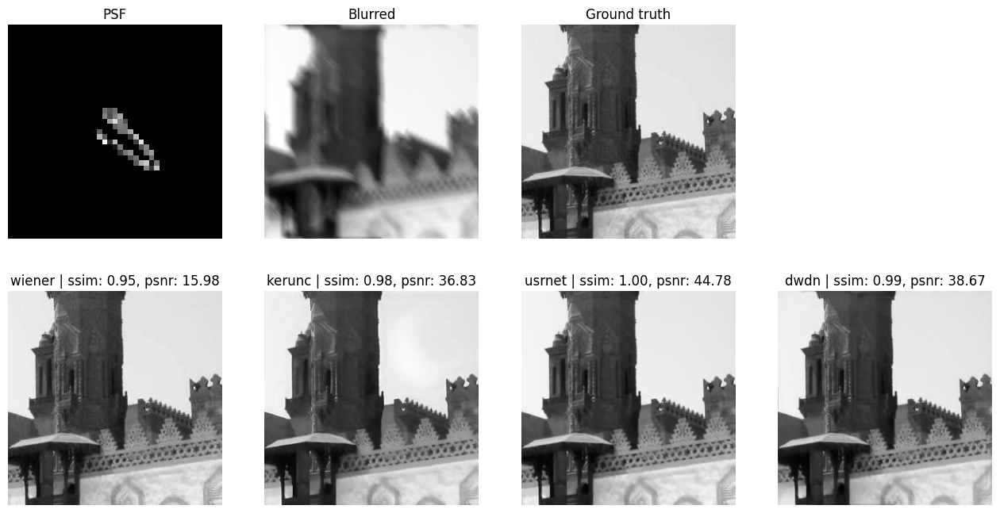

In [7]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_48.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-24.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

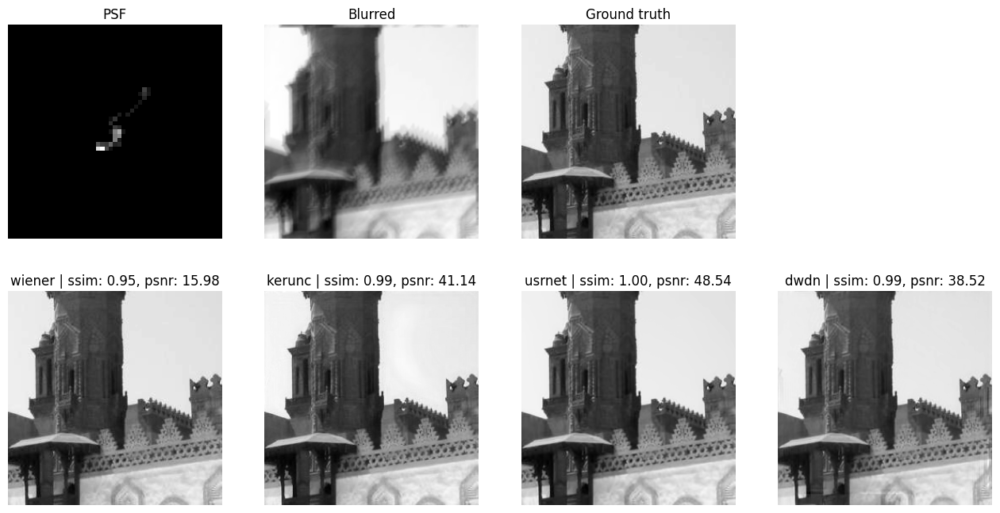

In [8]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_48.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-2.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

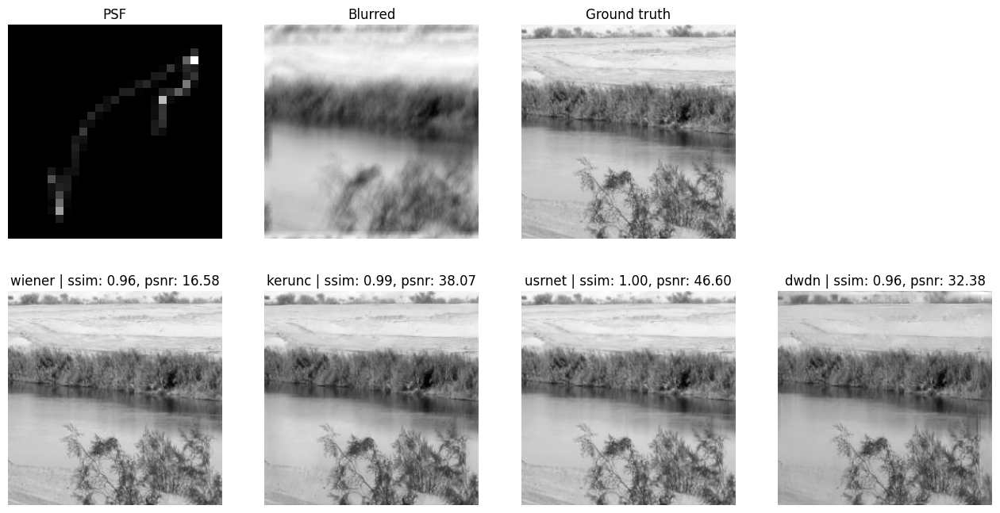

In [9]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_14.png',
    psf_path='../datasets/kernels/motion-blur/processed/Levin/levin-2.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

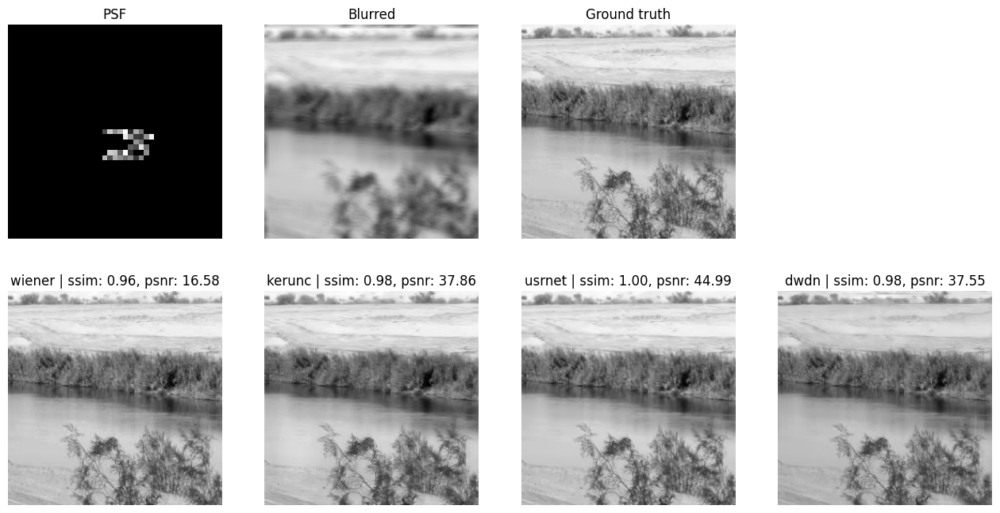

In [10]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_14.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-17.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

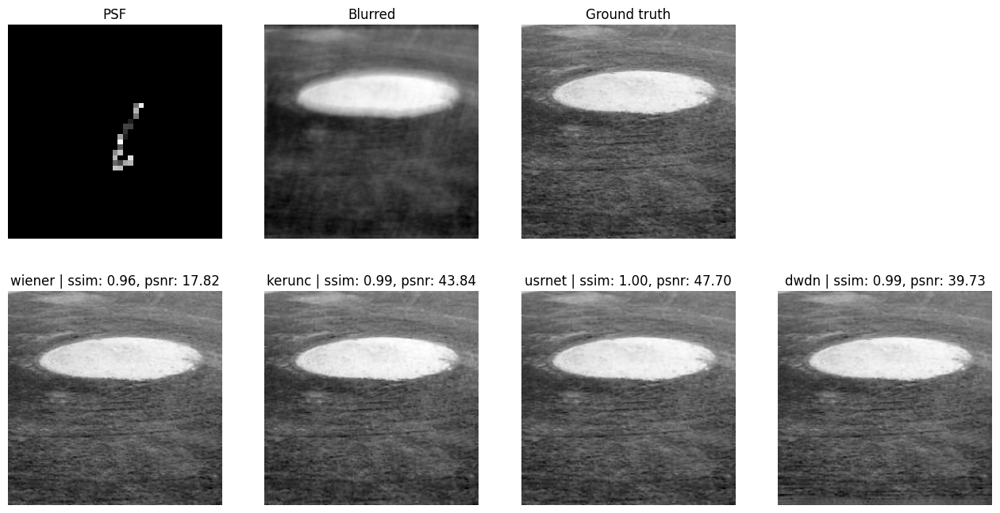

In [11]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_6.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-20.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

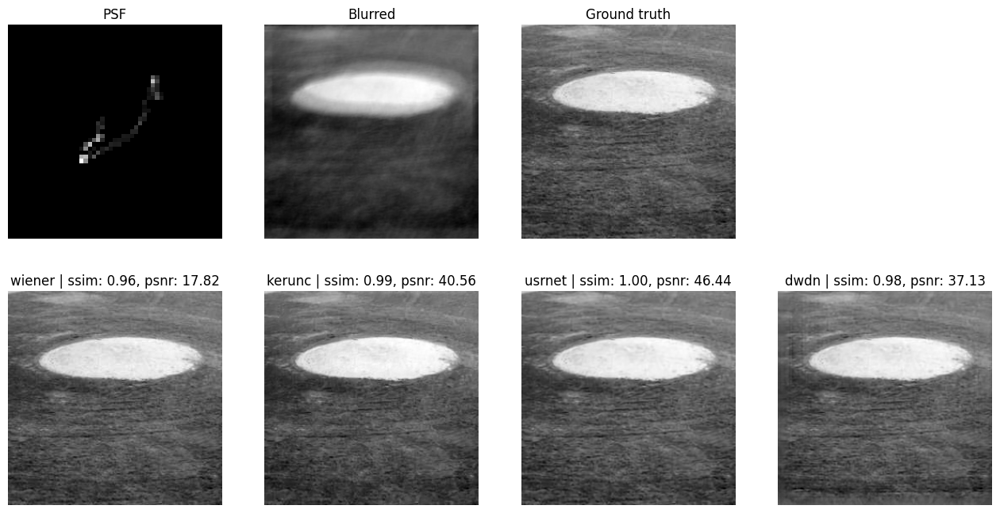

In [12]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_6.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-7.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

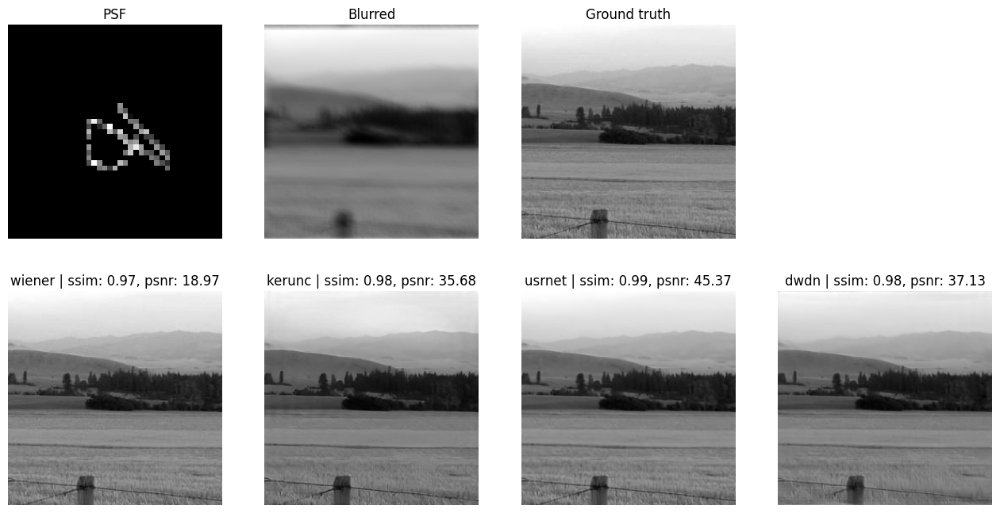

In [13]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_77.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-1.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

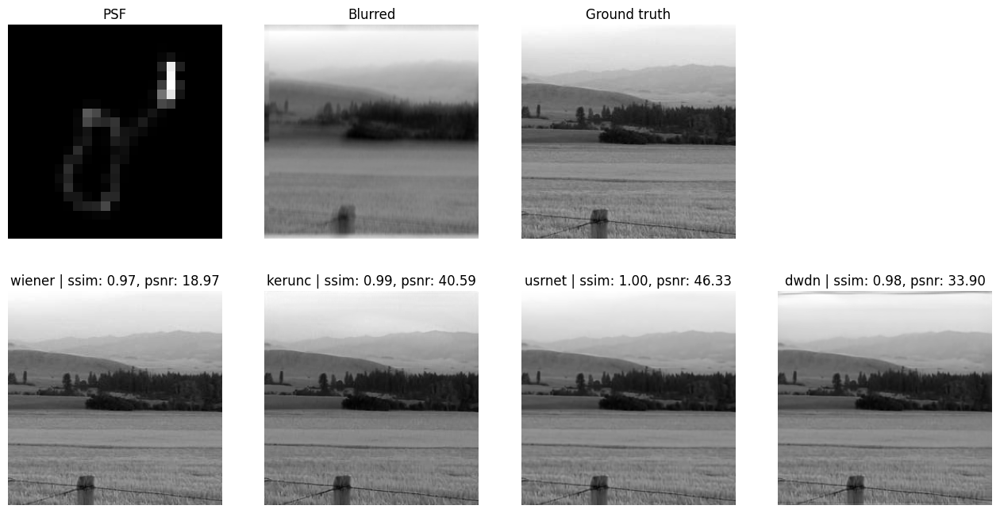

In [14]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_77.png',
    psf_path='../datasets/kernels/motion-blur/processed/Levin/levin-6.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

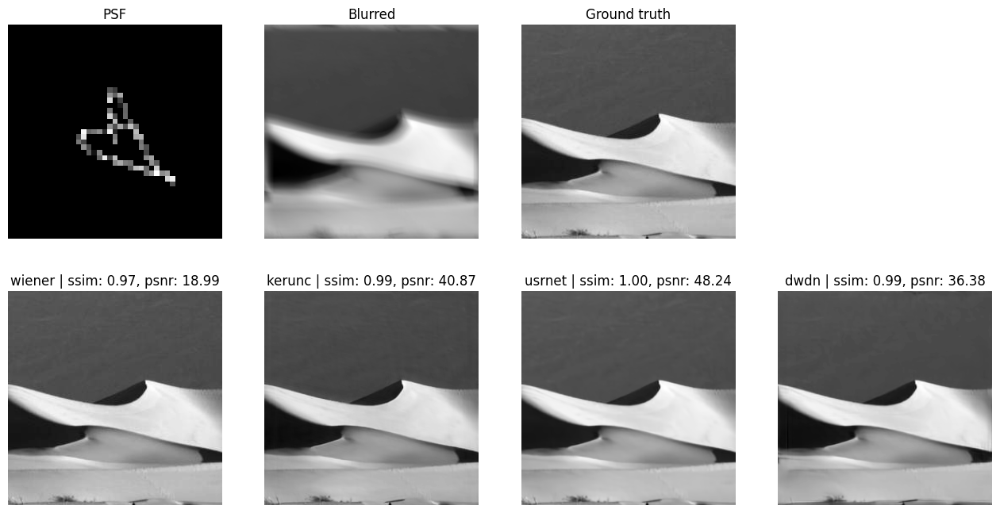

In [15]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_27.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-27.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

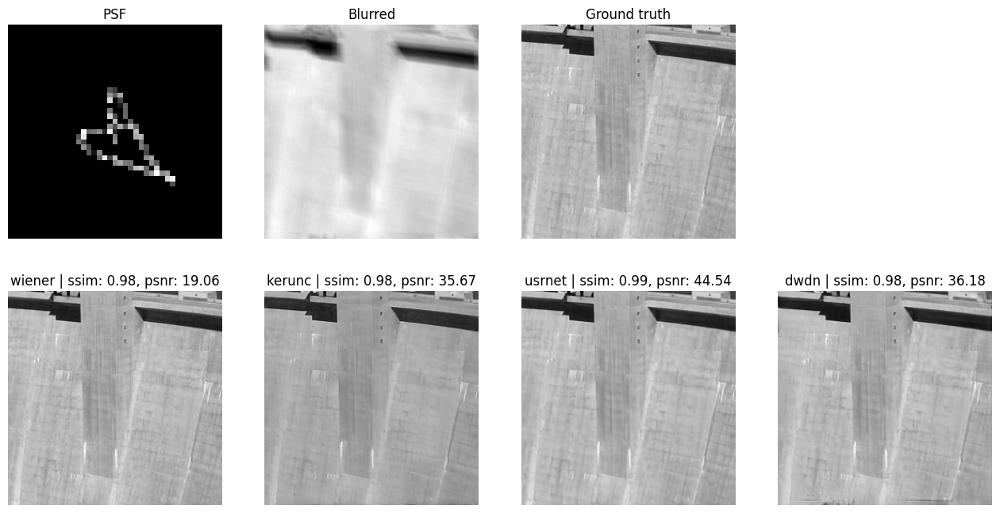

In [16]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_26.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-27.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

### Best Wiener restoration

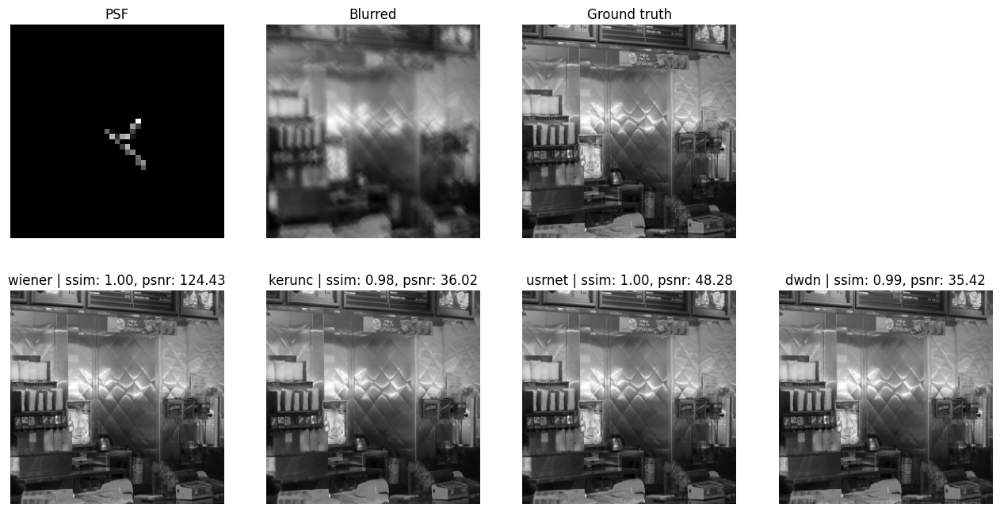

In [17]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_28.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-29.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

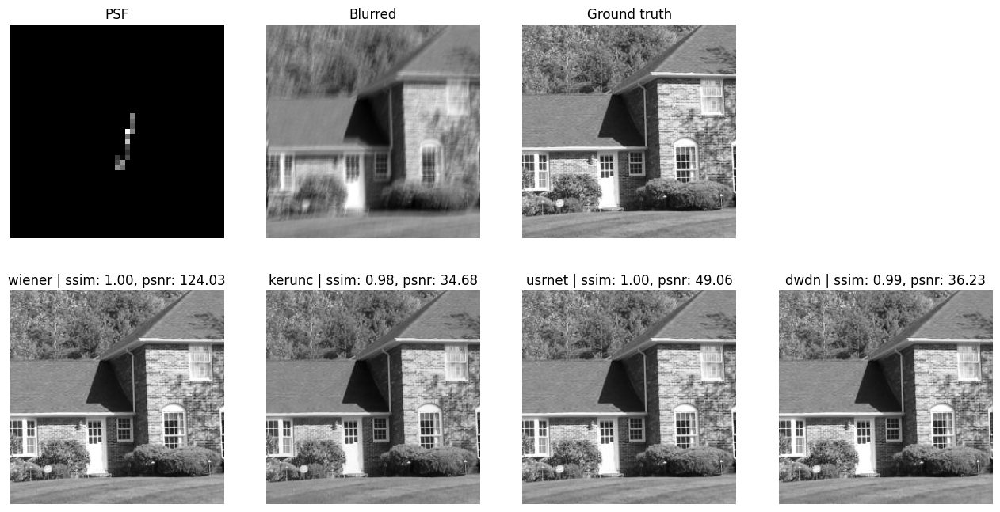

In [18]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_37.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-12.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

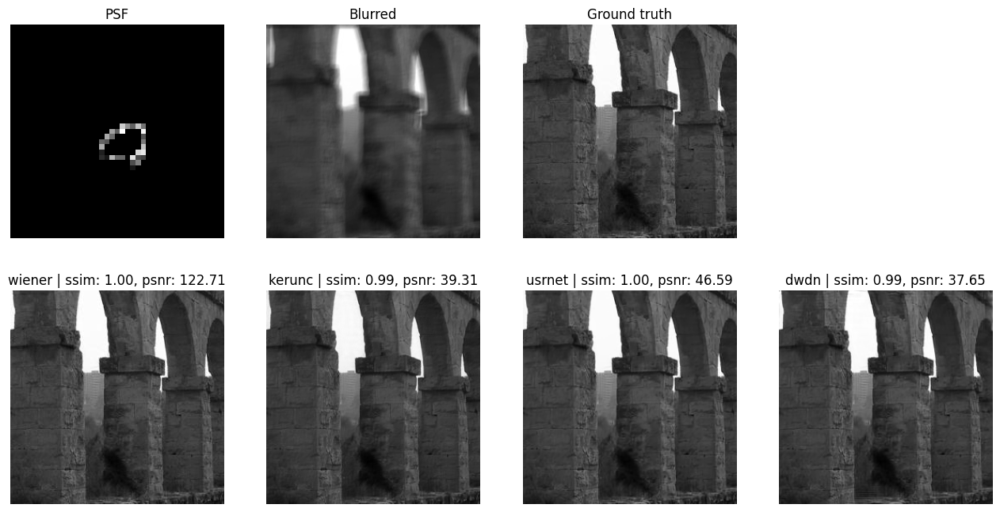

In [19]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_2.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-14.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

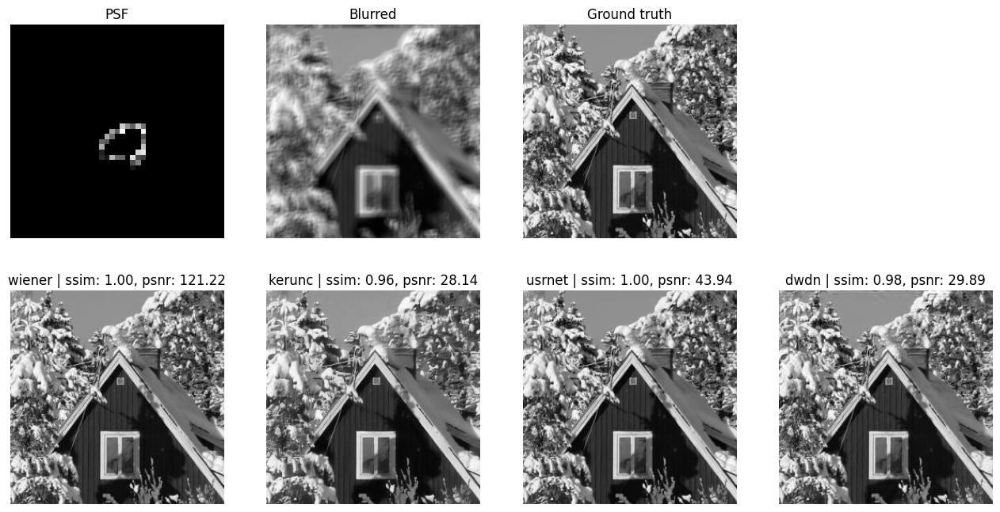

In [20]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_20.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-14.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

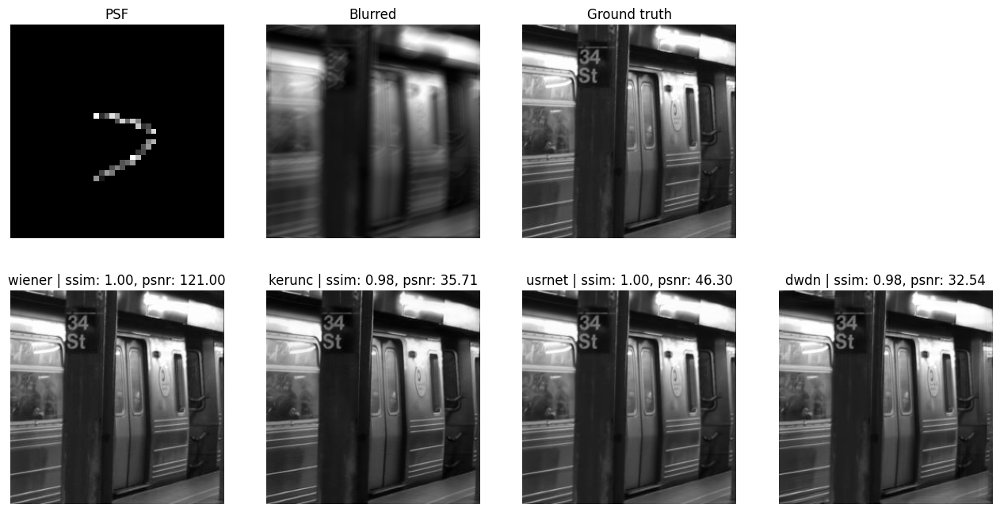

In [21]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_62.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-0.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

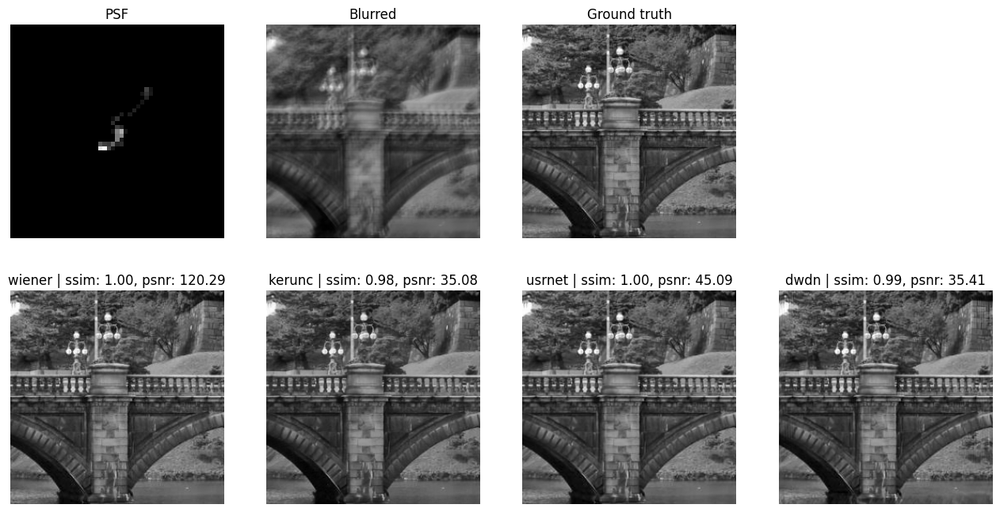

In [22]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_46.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-2.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

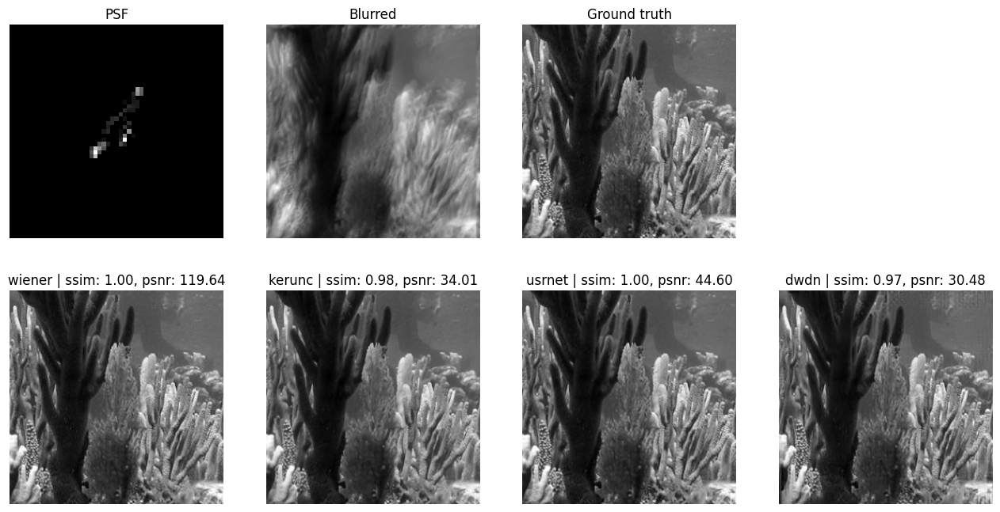

In [23]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_66.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-1.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

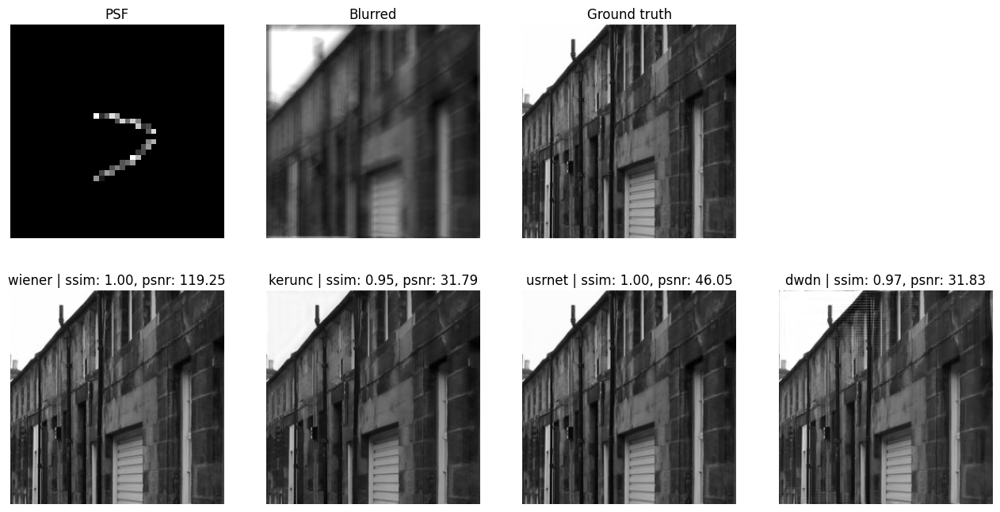

In [24]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_61.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-0.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

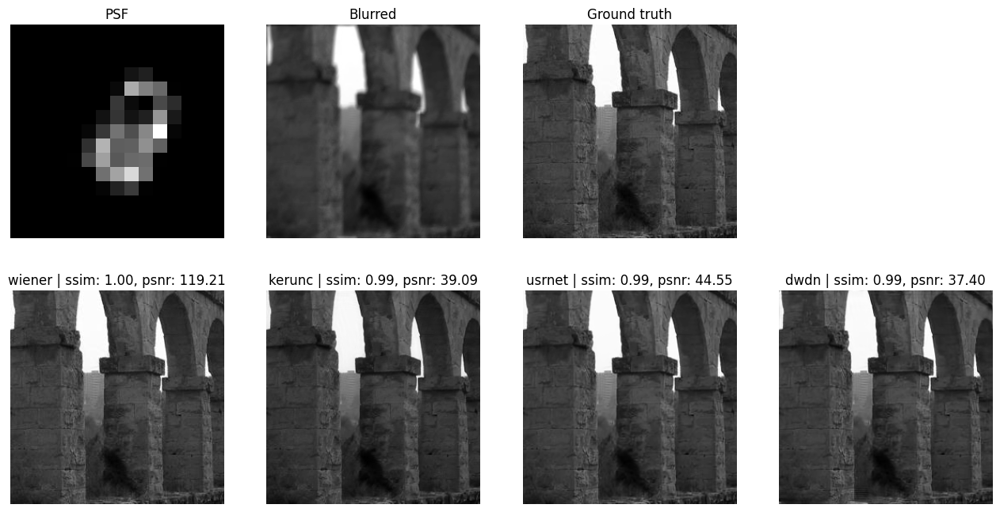

In [25]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_2.png',
    psf_path='../datasets/kernels/motion-blur/processed/Levin/levin-4.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

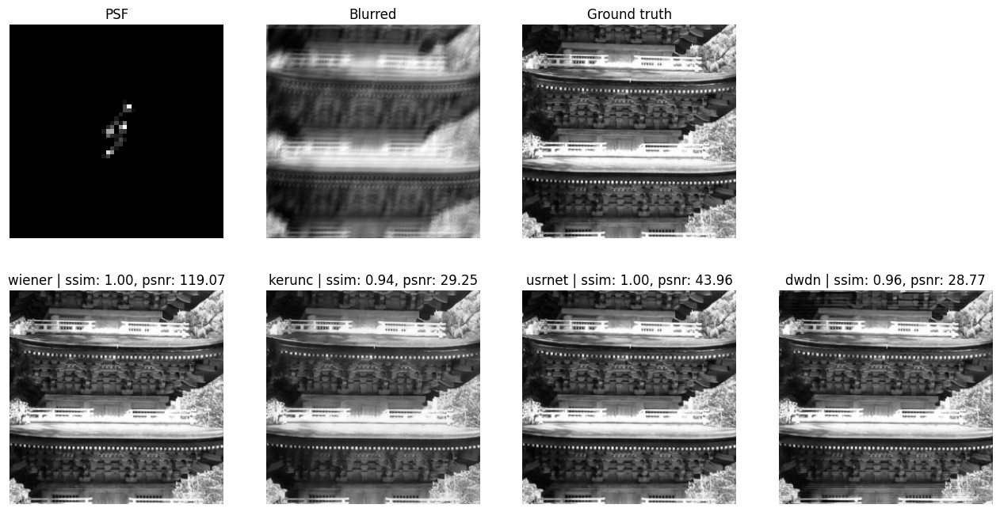

In [26]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_51.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-0.npy',
    is_noised=False,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=False)

# Noise case

### Worst Wiener restoration

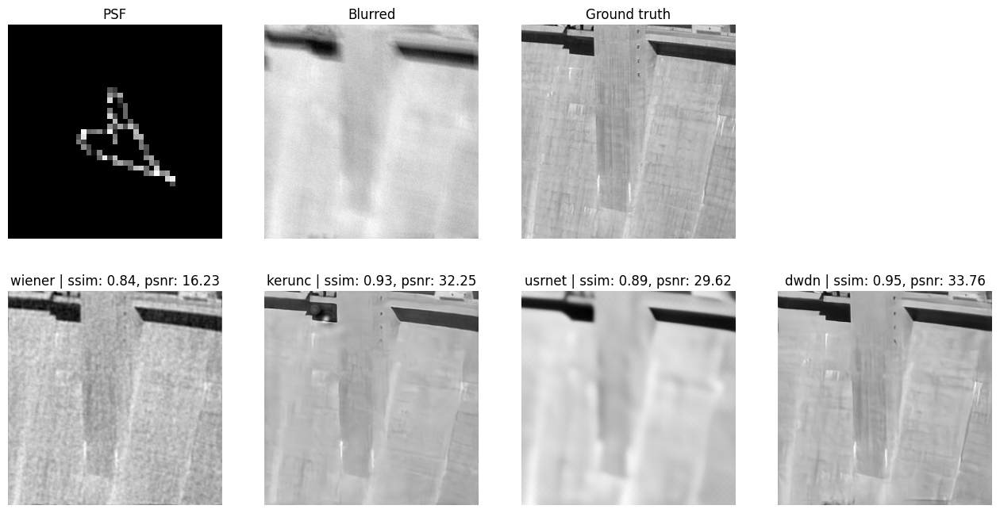

In [27]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_26.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-27.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

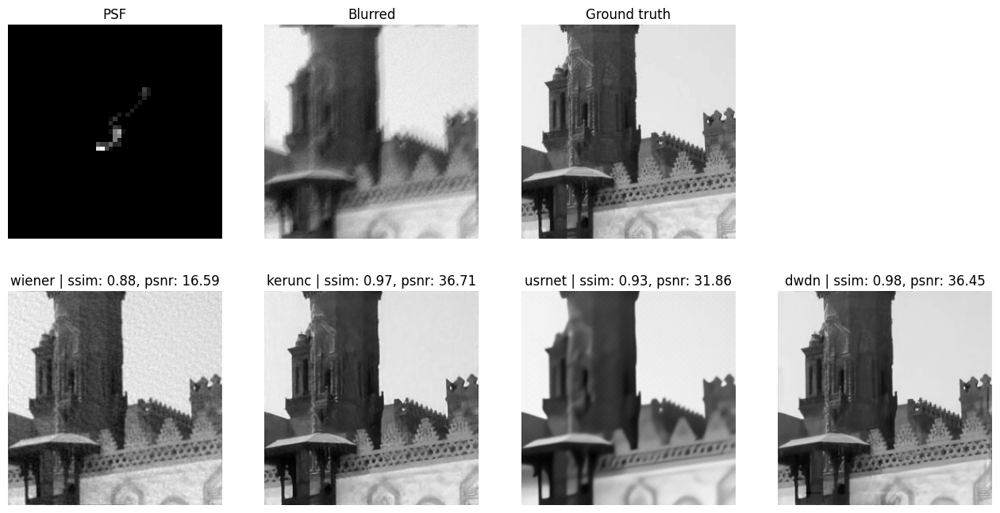

In [28]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_48.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-2.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

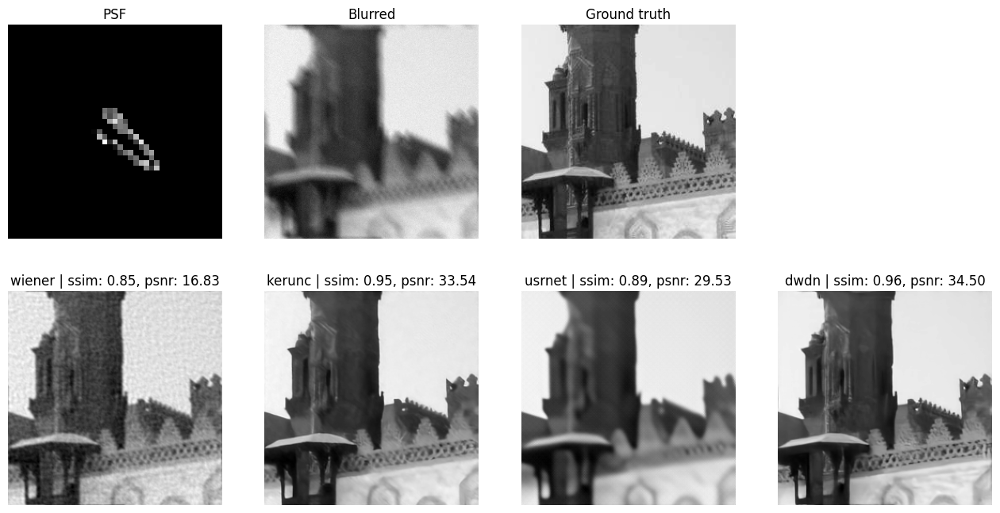

In [29]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_48.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-24.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

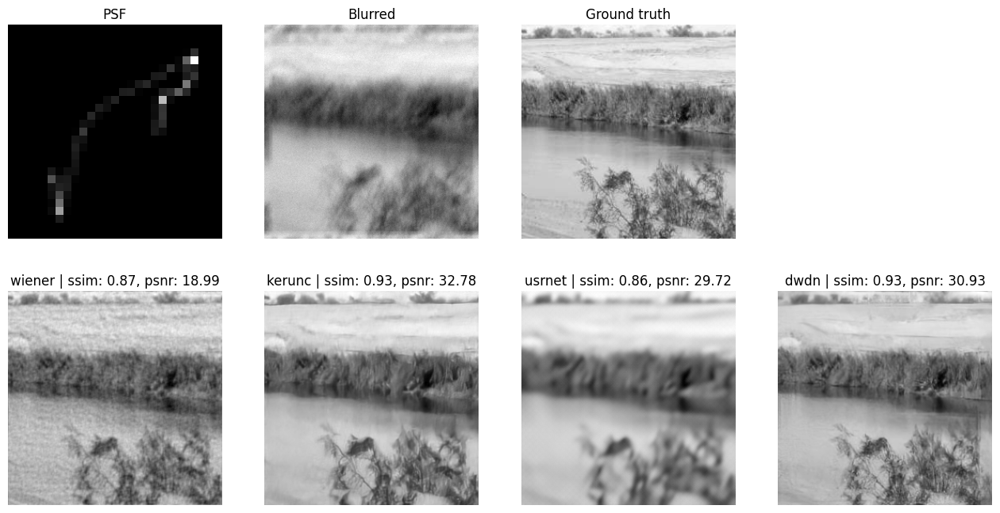

In [30]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_14.png',
    psf_path='../datasets/kernels/motion-blur/processed/Levin/levin-2.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

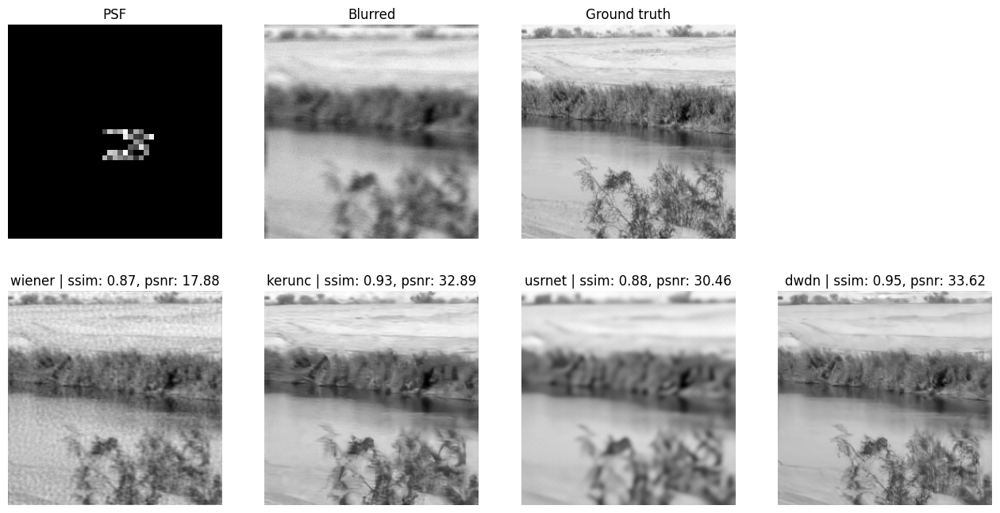

In [31]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_14.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-17.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

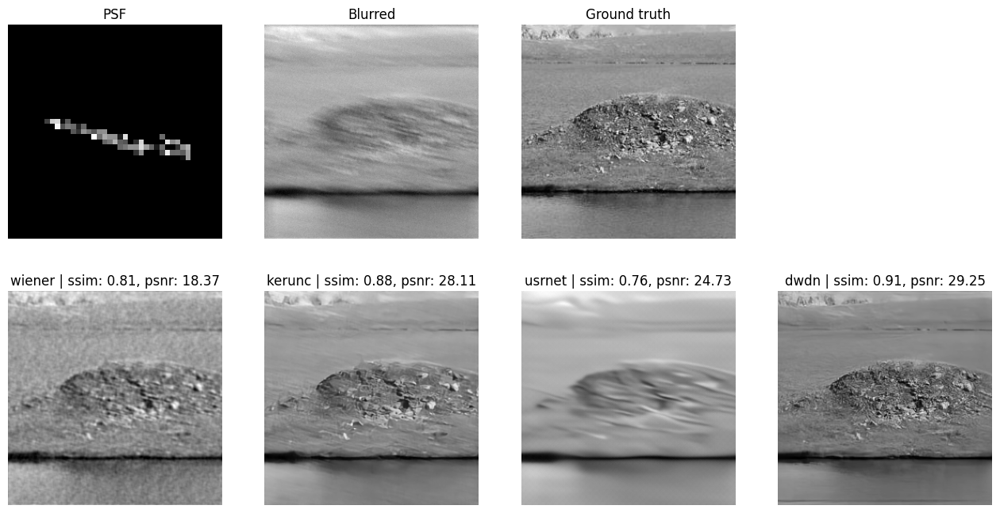

In [32]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_41.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-21.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

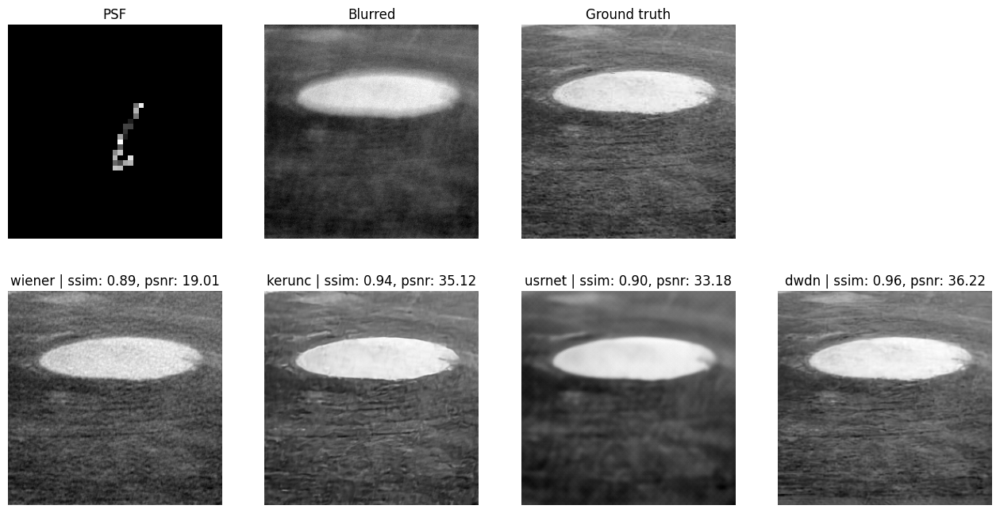

In [33]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_6.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-20.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

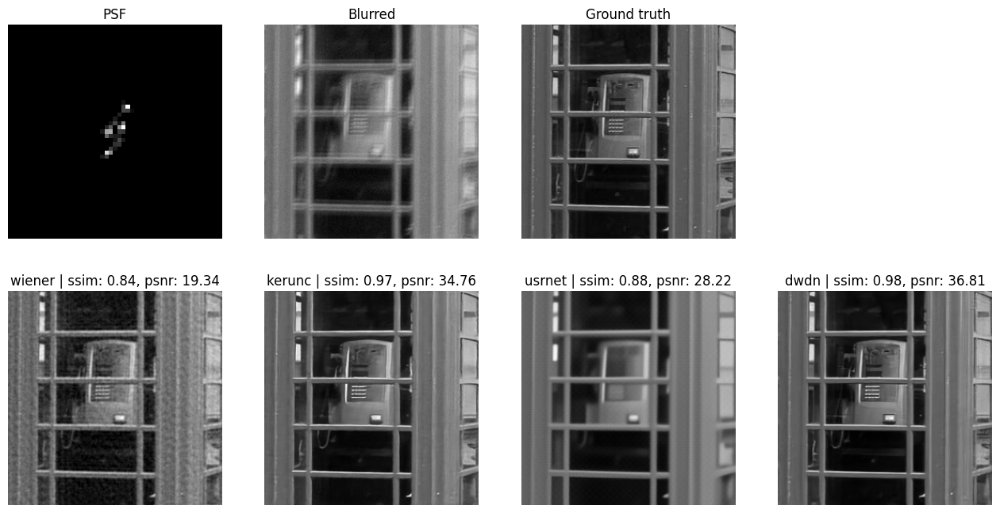

In [34]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_53.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-0.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

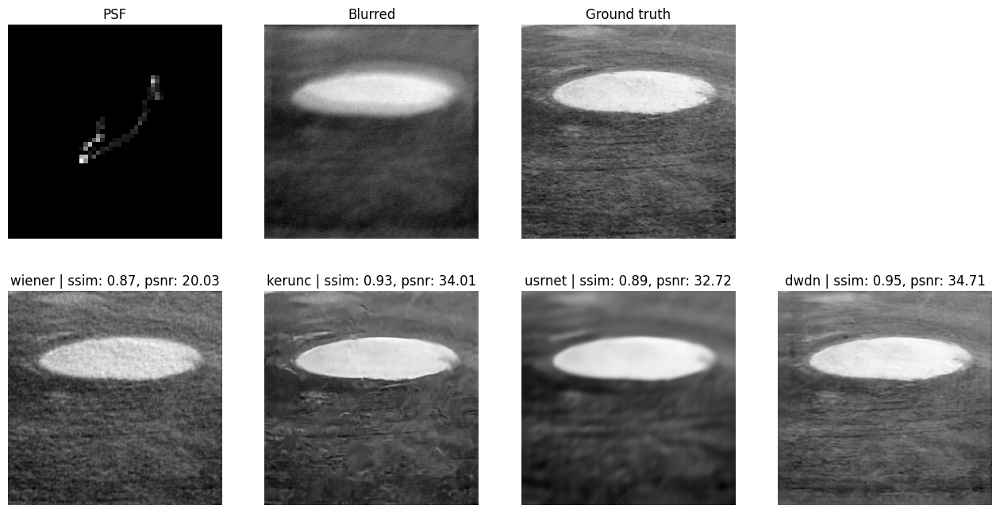

In [35]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_6.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-7.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

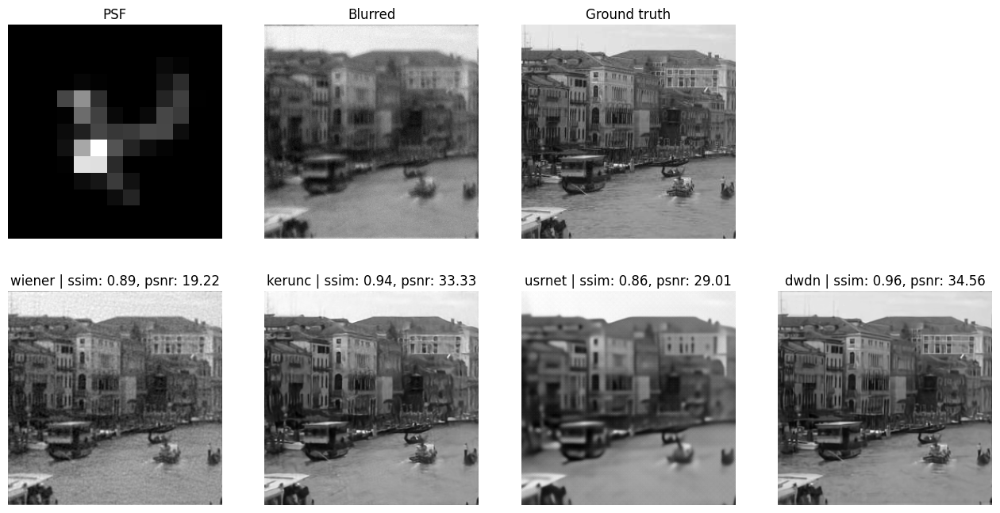

In [36]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_15.png',
    psf_path='../datasets/kernels/motion-blur/processed/Levin/levin-1.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

### Best Wiener restoration

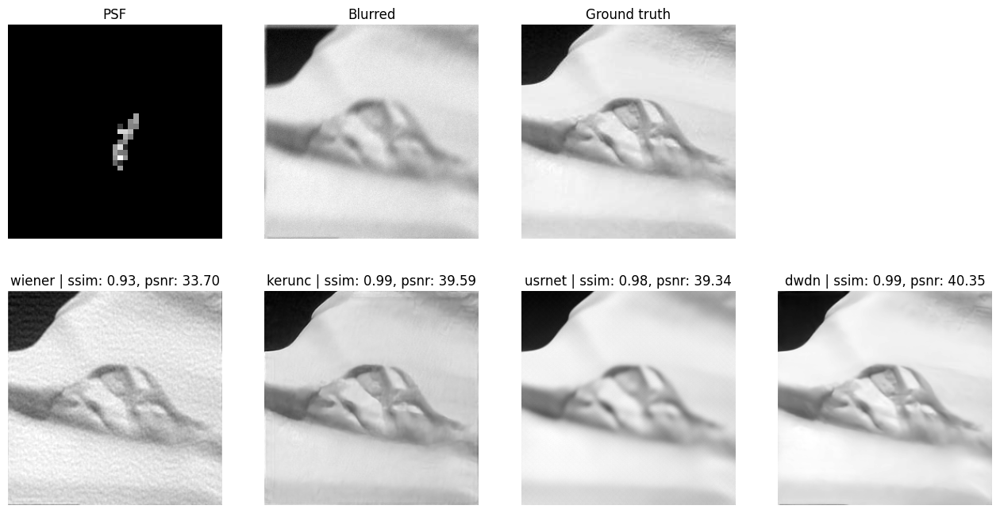

In [37]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_39.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-28.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

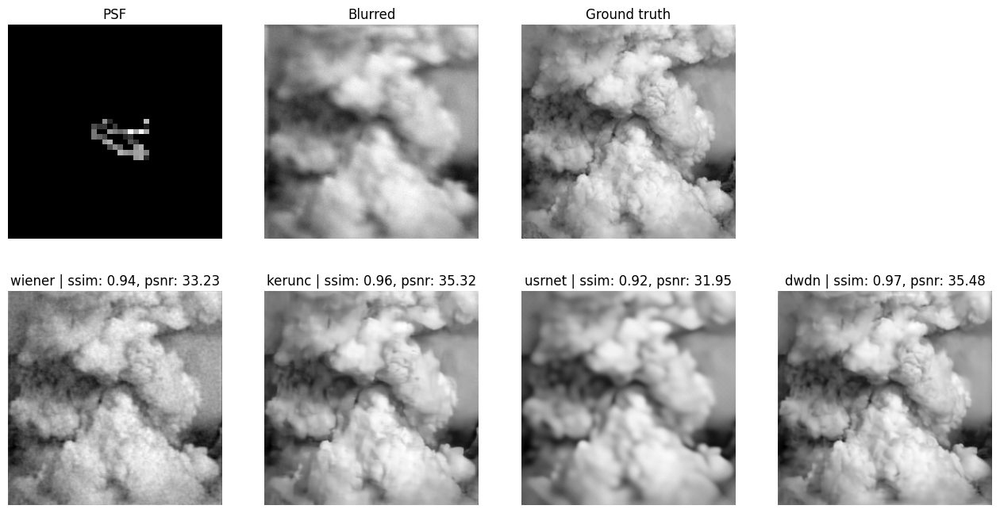

In [38]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_71.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-18.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

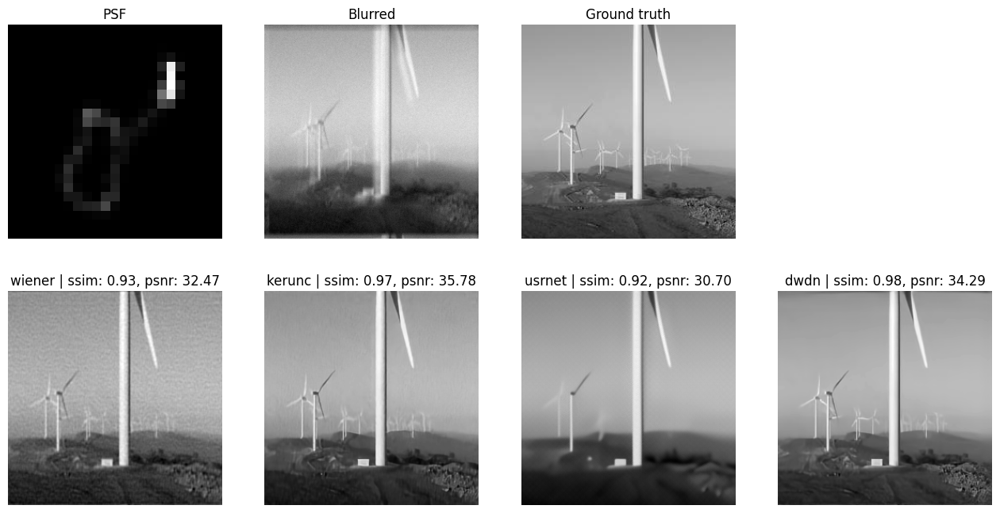

In [39]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_78.png',
    psf_path='../datasets/kernels/motion-blur/processed/Levin/levin-6.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

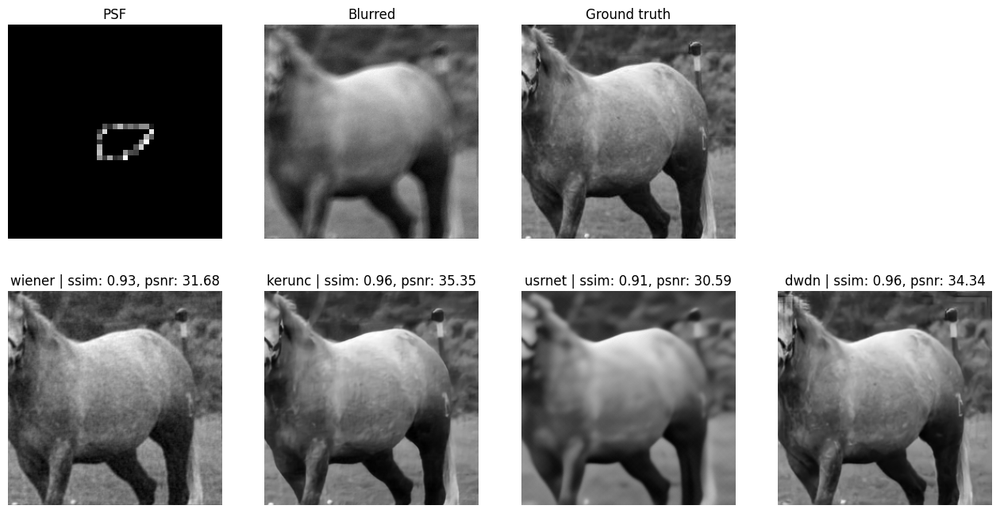

In [40]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_52.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-7.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

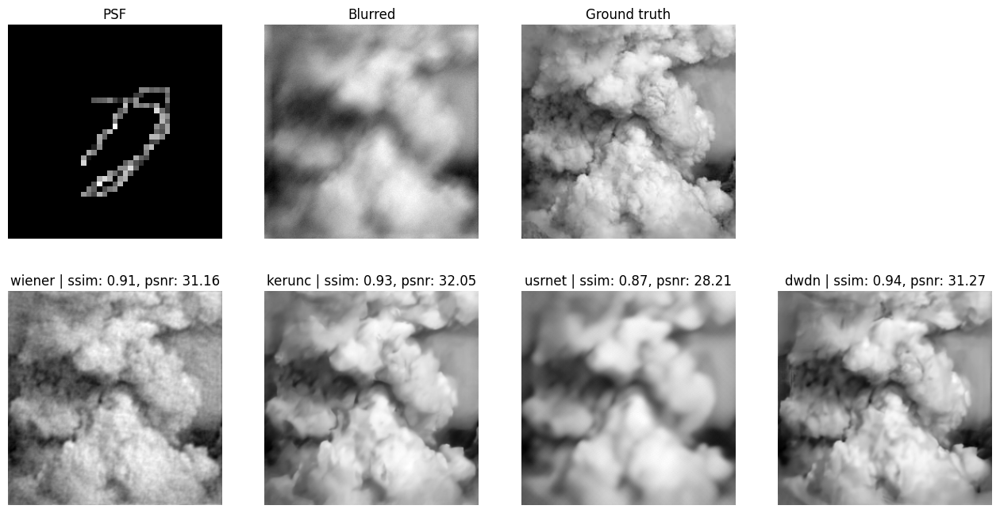

In [41]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_71.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-26.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

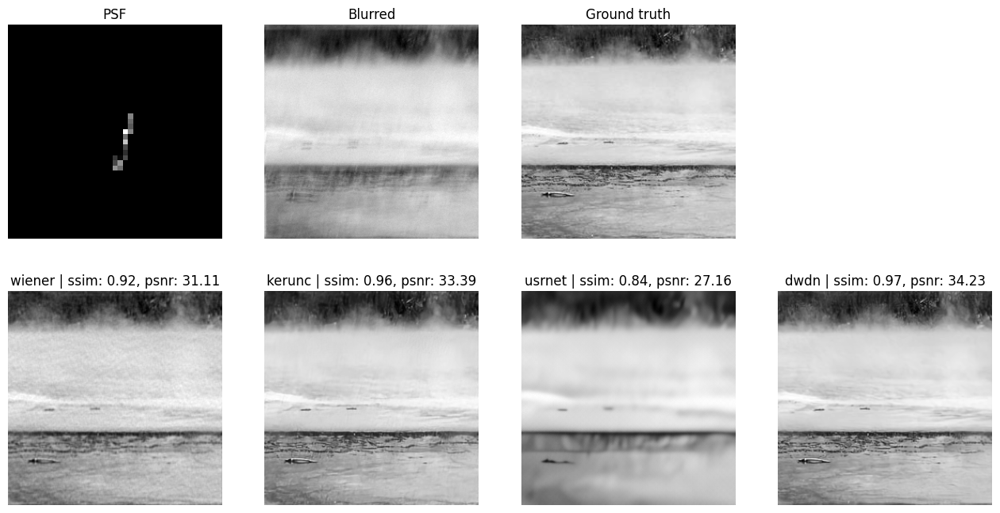

In [42]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_36.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-12.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

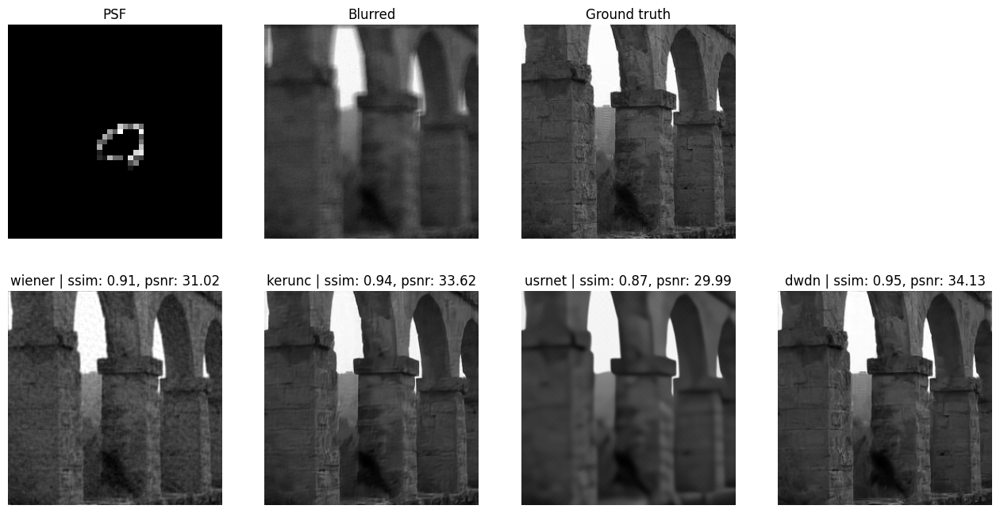

In [43]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_2.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-14.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

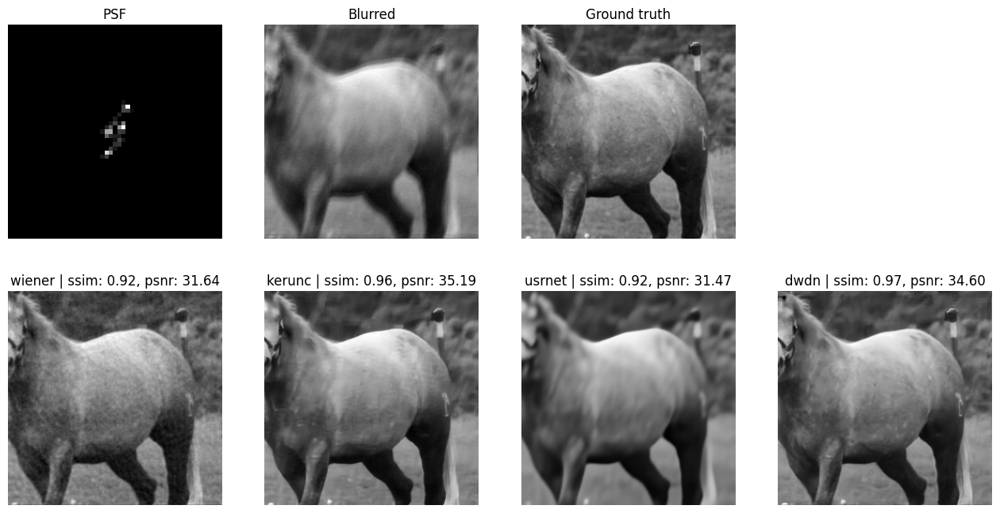

In [44]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_52.png',
    psf_path='../datasets/kernels/motion-blur/processed/Sun/sun-0.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

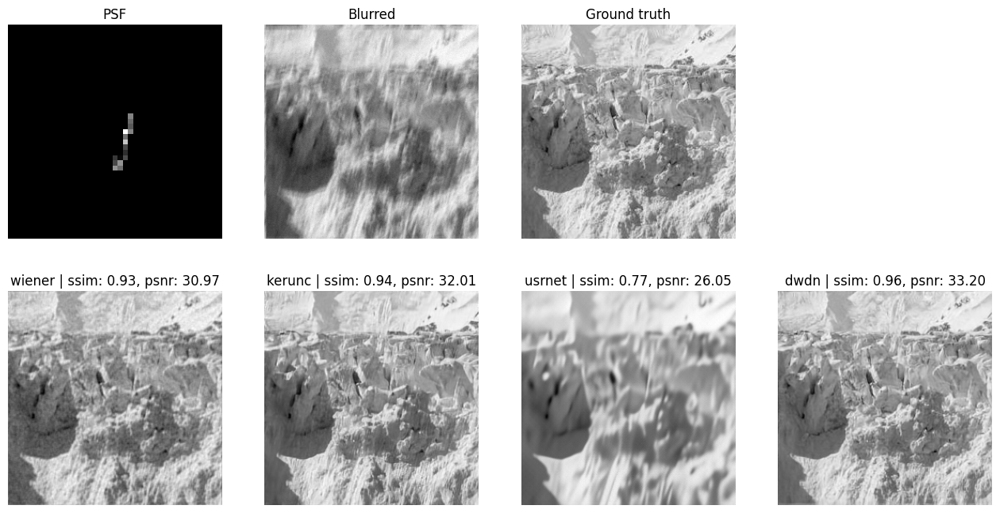

In [45]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_38.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-12.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

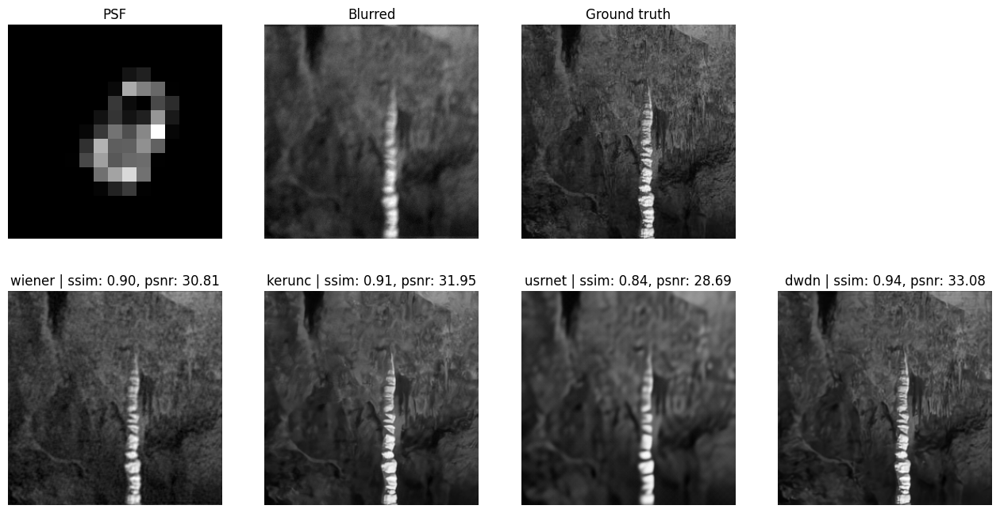

In [46]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_19.png',
    psf_path='../datasets/kernels/motion-blur/processed/Levin/levin-4.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

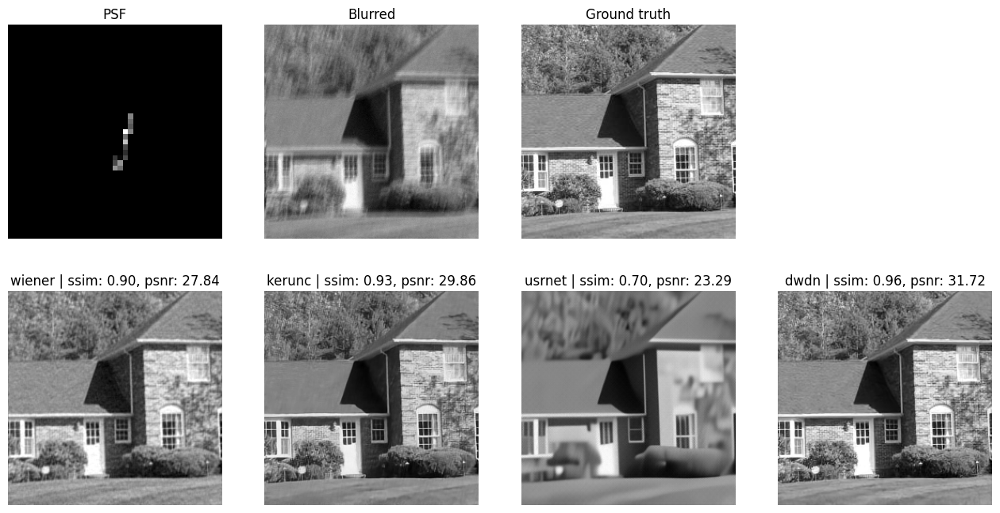

In [47]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_37.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-12.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

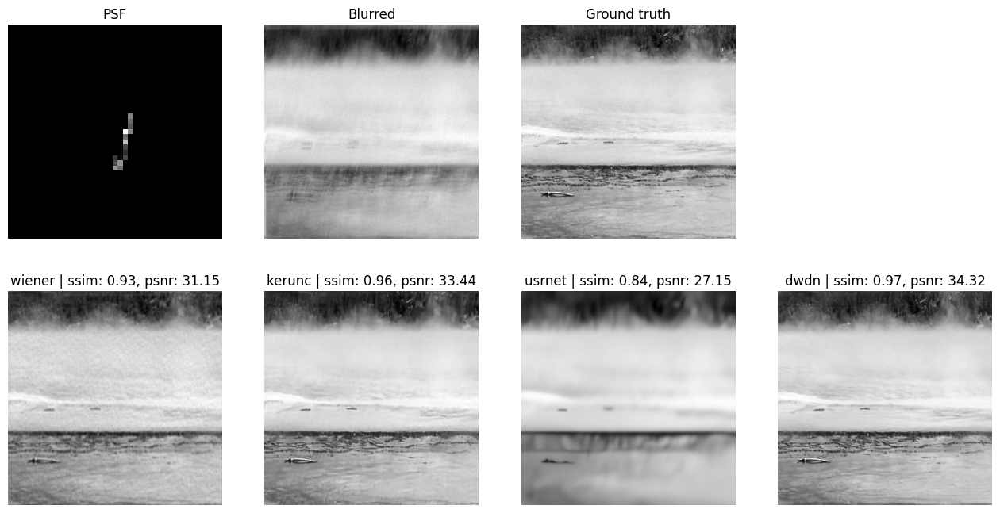

In [48]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_36.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-12.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

### Worst KerUnc restorations

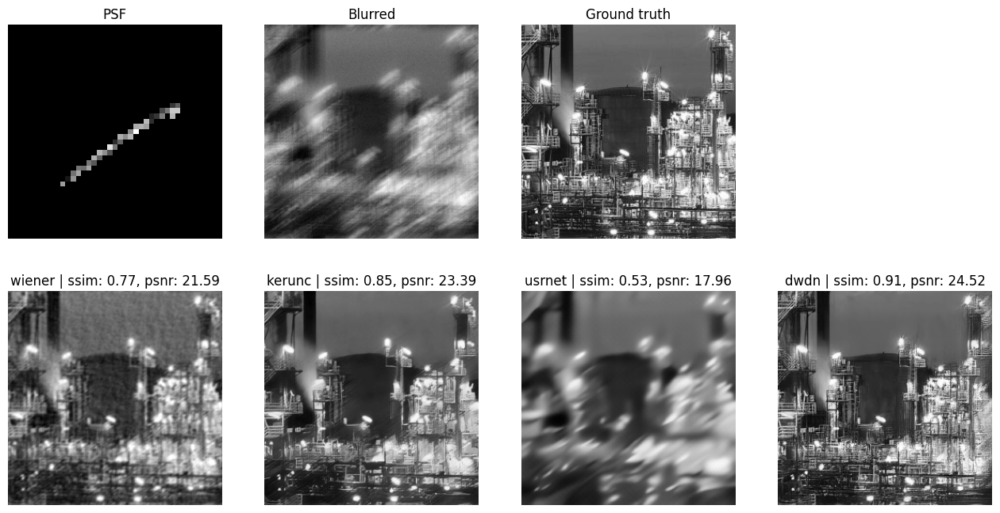

In [50]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_50.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-4.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

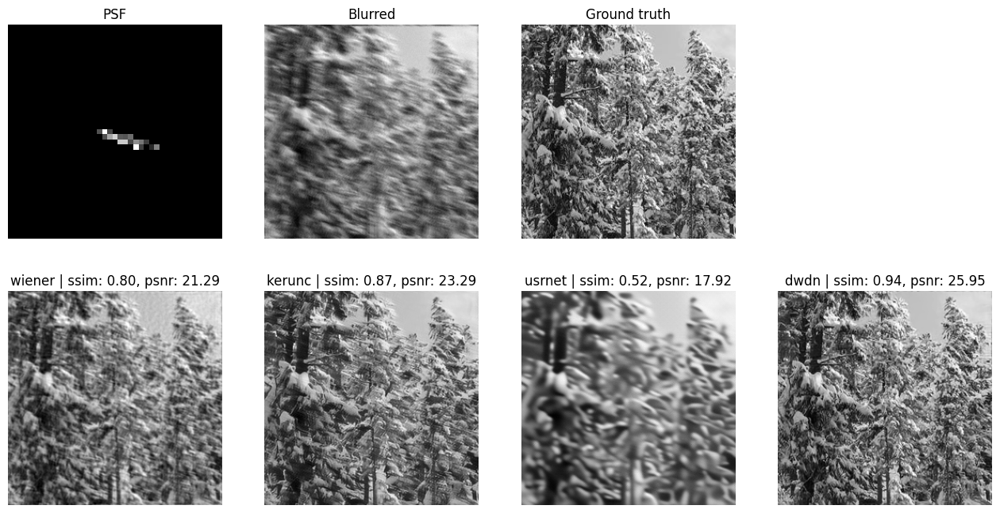

In [51]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_31.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-10.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)

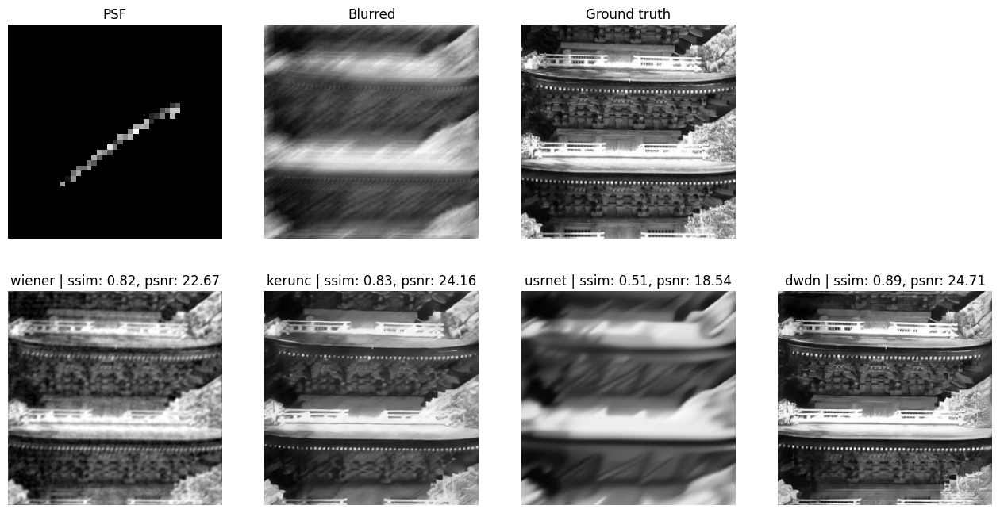

In [52]:
image, psf, blurred, blurred_3d = get_image_psf(
    image_path='../datasets/gt/Sun-gray/im_51.png',
    psf_path='../datasets/kernels/motion-blur/processed/synthetic/synthetic-4.npy',
    is_noised=True,
)

viz(image, psf, blurred, blurred_3d, models, is_noised=True)